In [1]:
import datetime
import pandas as pd
import numpy as np
from scipy import stats
from itertools import chain
from tabulate import tabulate
import matplotlib.pyplot as plt
from numerical_methods import EG, OU, regress, explanatory_matrix

import cufflinks as cf
cf.set_config_file(offline=True, dimensions=((1000,600)))

import warnings
warnings.filterwarnings("ignore")

## Trading Strategy and Backtesting

The class pairs_trading_backtest() is a combination of the trading strategy and backtesting. 

### Trading Strategy Part

- **fitting(X, Y)**: this method is for calculating the cointegration parameters ($\beta_{coint}$, $\mu_{e}$, $\sigma_{eq}$ and  halflife in days) used in the trading strategy.

    - Input **X**: the explanatory trading asset in Series
    
    - Input **Y**: the dependent trading asset in Series
    
    
    
- **trading(data, B_name, A_name, Z, Z_e, Z_s, spread, longcost, shortcost)**: this method is the core trading strategy. 

    - Input **data**: the dataset in DataFrame which contains the trading assets of the trading cointergration pair.The dataset used here could be different from the dataset in the fitting() method.
    
    - Input **B_name**: the column name in str of the explanatory trading asset in data
    
    - Input **A_name**: the column name in str of the dependent trading asset in data
    
    - Input **Z**: the number in float that multiplies $\sigma_{eq}$ to form the threshold of entry in the strategy
    
    - Input **Z_e**: the number in float that multiplies $\sigma_{eq}$ to form the threshold of exit when the residual reverts back to a value around the $\mu_{e}$; 0 by default
    
    - Input **Z_s**: the number in float that multiplies $\sigma_{eq}$ to form the threshold of exit when the residual goes too far away from the $\mu_{e}$; it is a stop loss parameter, 4 by default (almost no stop loss behaviour)
    
    - Input **spread**: the bid-ask spread of the trading asset in float or Series. The assumptions are: 1. the spread is the same for both trading asset at the same date; 2. the trading asset price is the mean of the ask price and bid price; 0 by default
    
    - Input **longcost**: the transaction cost in fraction of the trading amount when long the trading assets; 0 by default
    
    - Input **shortcost**: the transaction cost in fraction of the trading amount when short the trading assets; 0 by default
    
    
### Backtesting Part  

- **backtest(r, MADD)**: this method is the core part of backtesting. 
    
    - Input **MADD**: constant fraction of Maximum Acceptable Drawdown in float; 1.0 by default
    
    - Output **Backtest table**: a table including 
    
          1. Start Date
          2. End Date
          3. Total number of trades
          4. Average trades per year
          5. Average trading days(Calender)
          6. Annual Return
          7. Cumulative Return
          8. Average Return per trade
          9. Annual volatility
          10. Annual Alpha
          11. Beta
          12. Information Ratio
          13. Sharpe Ratio
          14. Max Drawdown
          15. Daily Value at Risk(99%)
          16. Drawdown Control
         
    - Output **Plots**: 10 plots
    
          1. Bid, Ask and Trading price of portfolio: portfolio consists of asset A - beta_coint asset B, when there is no spread nor transaction cost, bid, ask and trading prices of the portfolio are the same. In the plot, the position holding periods are shown in light green vertical spans.
                
          2. Residual: the time series plot of the residual of the cointegration pair. In the plot, the position holding periods are shown in light green vertical spans. The horizontal dashed lines indicate the exit thresholds, entry thresholds and stop-loss thresholds with colour of blue, pink and black respectively.
                             
          3. Cumulative Returns: plot of cumulative returns. The blue dashed line is the initial amount (1.0).
                
          4. Rolling Volatility: orange and blue curves represent the rolling annualised volatility with rolling window of 6 months and 12 months(1 year) respectively. The dashed lines are the average volatility corresponding to the rolling volatilities obtained by the two different rolling windows.
                                       
          5. Rolling Beta: orange and blue curves represent the rolling beta with rolling window of 6 months and 12 months(1 year) respectively. The dashed lines are the average beta corresponding to the rolling betas obtained by the two different rolling windows.
                                 
          6. Rolling Alpha: orange and blue curves represent the rolling alpha with rolling window of 6 months and 12 months(1 year) respectively. The dashed lines are the average alpha corresponding to the rolling alphas obtained by the two different rolling windows.
                                  
          7. Rolling Information Ratio: orange and blue curves represent the rolling information ratio with rolling window of 6 months and 12 months(1 year) respectively. The dashed lines are the average information ratio corresponding to the rolling information ratios obtained by the two different rolling windows.
                                              
          8. Rolling Sharpe Ratio: orange and blue curves represent the rolling Sharpe ratio with rolling window of 6 months and 12 months(1 year) respectively. The dashed lines are the average Sharpe ratio corresponding to the rolling Sharpe ratios obtained by the two different rolling windows.
                                         
          9. Underwater Plot: the plot of drawdowns. 
                                    
          10. Daily VaR 99%: the plot of daily VaR calculated using the parameters obtained from the rolling 6 month of historical data. The dashed blue line is the average VaR during the backtesting period.
          
          
- **get_return()**: this method returns the cumulative return

- **get_Sharpe_ratio()**: this method returns the average Sharpe Ratio

- **get_num_of_trades()**: this method returns the number of trades

- **get_return_per_trade()**: this method prints the return of each trade

- **get_vol()**: this method returns the annual volatility of the trading period

- **update_mu_e(bias)**: This method updates the $\mu_{e}$ to the slightly biased new mu_e based on the original one;
    
    - Input **bias**: the percentage of bias on the parameter $\mu_{e}$; $\mu_{e}$ is updated to $(1+{bias})\mu_{e}$


In [2]:
class pairs_trading_backtest():
    def __init__(self):
        """
        This class is a combination of the trading strategy and backtesting.
        """

    def fitting(self, X, Y):
        """
        Input parameters:
            X : Series
                Series with adjusted close prices of the explanatory trading asset.
            
            Y : Series
                Series with adjusted close prices of the dependent trading asset.   
                
        This method is to get the parameters: 
            loading (βcoint)
            resid (residual)
            mu_e (equilibrium μe)
            sigma_eq
            halflife (in days)
        """
        self.X = X
        self.Y = Y
        EGprocess = EG(self.X, self.Y)
        # coefficients
        coef = EGprocess.OLS(prt=False)
        self.est_const = coef[0]
        self.est_beta = coef[1]
        # loading
        self.loading = np.array([1, - coef[1]])
        # residual
        resid = self.Y - coef[1]*self.X - coef[0]
        del EGprocess
        
        OUprocess = OU(resid)
        OUprocess.fit(prt=False)
        # mu_e, sigma_eq, halflife
        self.mu_e, self.sigma_eq, self.halflife = OUprocess.reversion_parameters(prt=False)
        del OUprocess
        
    def trading(self, data, B_name, A_name, Z, Z_e=0, Z_s=4, spread=0, longcost=0, shortcost=0):
        """
        This method do the trading on the given dataset
           Input parameters:
            data: dataframe
                DataFrame with adjusted close prices of the explanatory trading asset.  
                
            B_name : str
                name of the explanatory trading asset.
            
            A_name : str
                name of the dependent trading asset.   
                
            Z : float
                Number that multiplies sigma_eq for entry
            
            Z_e: float
                Number that multiplies sigma_eq for exiting with default value of 0
                
            Z_s: float
                Number that multiplies sigma_eq for exiting to stop loss with default value of 4
                
            spread : float/dataframe
                Bid-ask spread value of constant for all day(float) or for each day(dataframe), with default value of 0
            
            longcost: float
                Transaction cost in fraction of the long transaction with default value of 0
                
            shortcost: float
                Transaction cost in fraction of the short transaction with default value of 0
        """
        # dataframe to record trading information
        trading_book = data.copy(deep=True)
        
        # dependent asset
        A = data[A_name]
        # explanatory asset
        B = data[B_name]
        
        ############## influence of spread#############
        ### price of long A (ask price of A)
        trading_book['ask_price_'+ A_name] = A + spread/2
        ### price of short A (bid price of A)
        trading_book['bid_price_'+ A_name] = A - spread/2
        ### price of long B (ask price of B)
        trading_book['ask_price_'+ B_name] = B + spread/2
        ### price of long B (bid price of B)
        trading_book['bid_price_'+ B_name] = B - spread/2
        # predicted A based on B
        A_estimate = self.est_const + self.est_beta * B
        # residual of A and predicted A
        resid = A - A_estimate
        trading_book['residual'] = resid
        
        # Verify the values of Z_e and Z_s
        if Z_e >= Z:
            print('Z_e should be less than Z!')
            return
        if Z_s <= Z:
            print('Z_s should be greater than Z!')
            return
        # entry thresholds
        entry_upper = self.mu_e + Z*self.sigma_eq
        entry_lower = self.mu_e - Z*self.sigma_eq
        # exit thresholds
        exit_upper = self.mu_e + Z_e*self.sigma_eq
        exit_lower = self.mu_e - Z_e*self.sigma_eq
        # stop loss thresholds
        stop_upper = self.mu_e + Z_s*self.sigma_eq
        stop_lower = self.mu_e - Z_s*self.sigma_eq
        # total number of trading 
        num_of_trades = 0
        # total PL
        PL = 0
        # Entry prices of A
        in_price_A = []
        # Entry prices of B
        in_price_B = []
        # Exit prices of A
        ex_price_A = []
        # Exit prices of B
        ex_price_B = []
        # Entry dates
        entry_dates = []
        # Exit dates(include exits of stopping loss)
        exit_dates = []
        # Trading P&Ls
        PL_trade = []
        # days of each trade
        days_trade = []
        
        ####################### generate the position status #########################
        # position status initialised to be all 0
        Status = len(trading_book) * [0]
        for idx in range(1, len(trading_book.index)):
            ######## residual goes down process#######
            # if the residual cross the stop loss upper bound - do nothing
            if trading_book['residual'][idx-1] > stop_upper and trading_book['residual'][idx] <= stop_upper:
                Status[idx] = Status[idx-1]
                
            # if the residual cross the entry upper bound - do nothing    
            elif trading_book['residual'][idx-1] > entry_upper and trading_book['residual'][idx] <= entry_upper:
                Status[idx] = Status[idx-1]
                
            # if the residual cross the exit upper bound - exit from the current status
            elif trading_book['residual'][idx-1] > exit_upper and trading_book['residual'][idx] <= exit_upper:
                Status[idx] = 0
            
            # if the residual cross the exit lower bound - do nothing 
            elif trading_book['residual'][idx-1] > exit_lower and trading_book['residual'][idx] <= exit_lower:
                Status[idx] = Status[idx-1]
        
            # if the residual cross the entry lower bound - long the loading
            elif trading_book['residual'][idx-1] > entry_lower and trading_book['residual'][idx] <= entry_lower:
                Status[idx] = 1
                
            # if the residual cross the stop loss lower bound - exit from the current status
            elif trading_book['residual'][idx-1] > stop_lower and trading_book['residual'][idx] <= stop_lower:
                Status[idx] = 0
            
            ######## residual goes up process#######
            
            # if the residual cross the stop loss lower bound - do nothing
            elif trading_book['residual'][idx-1] < stop_lower and trading_book['residual'][idx] >= stop_lower:
                Status[idx] = Status[idx-1]
            
             # if the residual cross the entry lower bound - do nothing
            elif trading_book['residual'][idx-1] < entry_lower and trading_book['residual'][idx] >= entry_lower:
                Status[idx] = Status[idx-1]
            
            # if the residual cross the exit lower bound - exit from the current status
            elif trading_book['residual'][idx-1] < exit_lower and trading_book['residual'][idx] >= exit_lower:
                Status[idx] = 0
            
            # if the residual cross the exit upper bound - do nothing
            elif trading_book['residual'][idx-1] < exit_upper and trading_book['residual'][idx] >= exit_upper:
                Status[idx] = Status[idx-1]
            
            # if the residual cross the entry upper bound - short the loading    
            elif trading_book['residual'][idx-1] < entry_upper and trading_book['residual'][idx] >= entry_upper:
                Status[idx] = -1

            # if the residual cross the stop loss upper bound - exit from the current status
            elif trading_book['residual'][idx-1] < stop_upper and trading_book['residual'][idx] >= stop_upper:
                Status[idx] = 0
                
            # for other cases - do nothing
            else:
                Status[idx] = Status[idx-1]

        # if status is not 0 in the last days, assume that this trade was not made and set the lastest non-zero squences to 0
        i = 1
        while(Status[-i] != 0):
            Status[-i] = 0
            i = i+1

        # position status
        trading_book['Status'] = Status
        
        ####################### generate the trading signal #########################
        # trading signal: 1 or 2 for long the loading, -1 or -2 for short the loading 
        # P.S. 2 means exit from the current position and entry in the opposite position on the same day
        trading_book['Signal'] = trading_book['Status'].diff().fillna(0)
        
        
        ###################### entry and exit  ######################
        # if Signal = 1(long the loading) and Status=1(in long position), then it is an entry
        # if Signal = -1(short the loading) and Status=-1(in short position), then it is an entry
        # if Signal = 1(long the loading) and Status=0(in clear position), then it is an exit
        # if Signal = -1(short the loading) and Status=0(in clear position), then it is an exit
        trading_book['Entry'] = trading_book['Signal'] * trading_book['Status']
        trading_book['Exit'] = [0] * len(trading_book['Status']) 
        trading_book.loc[(trading_book['Signal']!=0) & (trading_book['Status']==0),'Exit'] = 1
        # if Signal = 2 or -2, then entry and exit on the same day
        trading_book.loc[abs(trading_book['Signal'])==2, 'Entry'] = 1
        trading_book.loc[abs(trading_book['Signal'])==2, 'Exit'] = 1
        
        
        ####################### trading prices of portfolio #########################
        # considering the long and short costs: (1+longcost) for long, (1-shortcost) for short
        # trading prices the portfolio: 100% A and - est_beta% B
        # long portfolio = 100% ask_price_A*(1+longcost)  - est_beta% bid_price_B*(1-shortcost)
        trading_book['ask_price_port'] = \
            trading_book['ask_price_'+A_name] * (1 + longcost) - self.est_beta * trading_book['bid_price_'+B_name] * (1 - shortcost)
        # short portfolio = -[- 100% bid_price_A*(1-shortcost) + est_beta% bid_price_B*(1+longcost)]
        trading_book['bid_price_port'] = \
            - (- trading_book['bid_price_'+A_name] * (1-shortcost) + self.est_beta * trading_book['ask_price_'+B_name] * (1 + longcost))
        
        # portfolio trading price for each day: bid_price_port when we at long position(Status=1), other cases ask_price_port
        trading_book['price_port'] = trading_book['ask_price_port']
        trading_book.loc[trading_book['Status']==1,'price_port'] = trading_book.loc[trading_book['Status']==1,'bid_price_port']
        # Too big value of spread/transaction cost will make the portfolio price negative, which is not reasonable
        if len(trading_book[trading_book['price_port']<0])>0:
            print('Too much of spread or transaction costs make the portfolio price negative!')
            trading_book['price_port'].iplot(title = 'Portfolio Prices with Negative Values', legend=False)
            return
        
        
        ################################## P&L ###################################        
        trading_book['log_ret_port'] = np.log(trading_book['price_port']).diff()
        trading_book = trading_book.dropna()
        # daily PnL
        trading_book['PnL'] = trading_book['log_ret_port']*trading_book['Status']
        
        ############################ result summary #############################
        # total number of trades
        num_of_trades = abs(trading_book['Signal']).sum()/2
        # total PL
        PL = trading_book['PnL'].sum()
        # Entry dates
        entry_dates = list(trading_book[trading_book['Entry']==1].index)
        # Exit dates(include exits of stopping loss)
        exit_dates = list(trading_book[trading_book['Exit']==1].index)
        
        # Entry prices of A and B (not include transaction cost)
        for date in entry_dates:
            if trading_book.loc[date, 'Signal'] > 0:   
                ### long the portfolio = long A + short B ###
                # Entry prices of A
                in_price_A.append(trading_book.loc[date ,'ask_price_'+A_name])
                # Entry prices of B
                in_price_B.append(trading_book.loc[date ,'bid_price_'+B_name])
            elif trading_book.loc[date, 'Signal'] < 0:
                ### short the portfolio = short A + long B ###
                # Entry prices of A
                in_price_A.append(trading_book.loc[date ,'bid_price_'+A_name])
                # Entry prices of B
                in_price_B.append(trading_book.loc[date ,'ask_price_'+B_name])
        
        # Exit prices of A and B (not include transaction cost)
        for date in exit_dates:
            if trading_book.loc[date, 'Signal'] > 0:   
                ### long the portfolio = long A + short B ###
                # Exit prices of A
                ex_price_A.append(trading_book.loc[date ,'ask_price_'+A_name])
                # Exit prices of B
                ex_price_B.append(trading_book.loc[date ,'bid_price_'+B_name])
            elif trading_book.loc[date, 'Signal'] < 0:
                ### short the portfolio = short A + long B ###
                # Exit prices of A
                ex_price_A.append(trading_book.loc[date ,'bid_price_'+A_name])
                # Exit prices of B
                ex_price_B.append(trading_book.loc[date ,'ask_price_'+B_name])

        
        for i in range(len(entry_dates)):
            # Trading P&Ls
            PL_trade.append(trading_book.loc[entry_dates[i]:exit_dates[i], 'PnL'].sum())
            # Average days of trade
            days_trade.append((datetime.datetime.strptime(exit_dates[i],'%Y-%m-%d').date() 
                              - datetime.datetime.strptime(entry_dates[i], '%Y-%m-%d').date()).days)
        
        # Average return per tarde
        if num_of_trades!=0:
            PL_per_trade = np.mean(PL_trade)
        else:
            PL_per_trade = 'No Trade'
        
        # Sharpe Ratio with 0 risk-free interest
        self.SR = (252*trading_book['PnL'].mean())/(np.sqrt(252)*trading_book['PnL'].std())
        
        self.summary = {
                      'Trading Book': trading_book,
                      'Cummulative Return': PL,
                      'Annualised Return': PL * 252/len(trading_book),
                      'Total number of trades': num_of_trades,
                      'Return per trade': PL_trade,
                      'Average Return per trade': PL_per_trade,
                      'Days per trade': days_trade,
                      'Entry Dates': entry_dates,
                      'Exit Dates': exit_dates,
                      'Entry prices for '+A_name: in_price_A, 
                      'Entry prices for '+B_name: in_price_B, 
                      'Exit prices for '+A_name: ex_price_A, 
                      'Exit prices for '+B_name: ex_price_B,
                      'entry_upper': entry_upper,
                      'entry_lower': entry_lower,
                      'exit_upper': exit_upper,
                      'exit_lower': exit_lower,
                      'stop_upper': stop_upper,
                      'stop_lower': stop_lower
        }
    
    
    ################################ Backtest Part ###################################
    def backtest(self, MADD=1.0, output=True):
        """
        This method is the backtesting module that outputs a table containing the backtesting information and 
        10 plots. It takes two extra inputs:
            
        Input parameters:
            MADD: float
                the maximum acceptable drawdown of the trader, with maximun value of 1.0 and minimun value of 0
                and default value of 1.0
                
            output: bool
                whether to print the table and plots; with default value of True
             
        Output:
            Table: containing information of 
                1. Start Date
                2. End Date
                3. Total number of trades
                4. Average trades per year
                5. Average trading days(Calender)
                6. Annual Return
                7. Cumulative Return
                8. Average Return per trade
                9. Annual volatility
                10. Annual Alpha
                11. Beta
                12. Information Ratio
                13. Sharpe Ratio
                14. Max Drawdown
                15. Daily Value at Risk(99%)
                16. Drawdown Control
            
            Plots: including
                1. Bid, Ask and Trading price of portfolio: portfolio consists of asset A - beta_coint asset B, when there
                                                            is no spread nor transaction cost, bid ask and trading prices of
                                                            the portfolio are the same. In the plot, the position holding
                                                            periods are shown in light green vertical spans.
                
                2. Residual: the time series plot of the residual of the cointegration pair. In the plot, the position holding
                             periods are shown in light green vertical spans. The horizontal dashed lines indicate the exit
                             thresholds, entry thresholds and stoploss thresholds with colour of blue, pink and black
                             respectively.
                             
                3. Cumulative Returns: plot of cumulative returns. The blue dashed line is the initial amount (1.0).
                
                4. Rolling Volatility: orange and blue curves represent the rolling annualised volatility with rolling 
                                       window of 6 months and 12 months(1 year) respectively. The dashed lines are the average 
                                       volatility corresponding to the rolling volatilities obtained by the two different 
                                       rolling windows.
                                       
                5. Rolling Beta: orange and blue curves represent the rolling beta with rolling window of 6 months
                                 and 12 months(1 year) respectively. The dashed lines are the average beta 
                                 corresponding to the rolling betas obtained by the two different rolling windows.
                                 
                6. Rolling Alpha: orange and blue curves represent the rolling alpha with rolling window of 6 months
                                  and 12 months(1 year) respectively. The dashed lines are the average alpha 
                                  corresponding to the rolling alphas obtained by the two different rolling windows.
                                  
                7. Rolling Information Ratio: orange and blue curves represent the rolling information ratio with rolling 
                                              window of 6 months and 12 months(1 year) respectively. The dashed lines are
                                              the average information ratio corresponding to the rolling information ratios
                                              obtained by the two different rolling windows.
                                              
                8. Rolling Sharpe Ratio: orange and blue curves represent the rolling Sharpe ratio with rolling 
                                         window of 6 months and 12 months(1 year) respectively. The dashed lines are
                                         the average Sharpe ratio corresponding to the rolling Sharpe ratios
                                         obtained by the two different rolling windows.
                                         
                9. Underwater Plot: the plot of drawdowns. 
                                    
                10. Daily VaR 99%: the plot of daily VaR calculated using the parameters obtained from the rolling 6 month of
                                   historical data. The dashed blue line is the average VaR during the backtesting period.
        """
        
        # load the market price
        mkt_data = pd.read_csv('SP500.csv', index_col='Date')
        mkt_data['Market Return'] = np.log(mkt_data['Adj Close']).diff().dropna()
        # construct the dataframe for backtest
        backtest_book = pd.concat([self.summary['Trading Book']['PnL'], mkt_data['Market Return']], axis=1).dropna()
        
        ##################### Rolling volatility ####################
        def get_vol(df):
            if np.std(df)!=0:
                # annualised Sharpe Ratio
                return np.sqrt(252)*np.std(df)
            else:
                return 0
            
        backtest_book['Volatility 6M'] = backtest_book['PnL'].rolling(126).apply(get_vol, raw=False)
        backtest_book['Volatility 1Y'] = backtest_book['PnL'].rolling(252).apply(get_vol, raw=False)

        ################# Rolling Alpha, Beta, Information Ratio ################
        def get_alpha_beta(window, period, mkt_ret=backtest_book['Market Return'], strategy_ret=backtest_book['PnL']):
            alpha = [0]*len(backtest_book)
            beta = [0]*len(backtest_book)
            ir = [0]*len(backtest_book)
            for i in range(len(backtest_book)-window):
                # form dependent vector
                strategy_ret_mat = (strategy_ret.iloc[i:i+window]).values.T
                # form explanatory matrix
                mkt_ret_mat = explanatory_matrix((mkt_ret.iloc[i:i+window]), 0)
                # regress
                res = regress(mkt_ret_mat, strategy_ret_mat)
                coef = res['coef']
                sigma = np.std(res['resid'])
                # get annualised alpha
                alpha[i+window] = coef[0]*252
                # get beta
                beta[i+window] = coef[1]
                # get annualised information ratio
                if sigma!=0:
                    ir[i+window] = (252*coef[0])/(np.sqrt(252)*sigma)
                else:
                    ir[i+window] = 0
            backtest_book['alpha '+period] = alpha
            backtest_book['beta '+period] = beta
            backtest_book['Information Ratio(IR) '+period] = ir
            return 
        
        get_alpha_beta(window=126, period='6M')
        get_alpha_beta(window=252, period='1Y')
            
        ################# Rolling Sharpe Ratio ################
        def get_sharpe_ratio(df):
            if np.std(df)!=0 and np.mean(df)!=0:
                # annualised Sharpe Ratio
                return (252*np.mean(df))/(np.sqrt(252)*np.std(df))
            else:
                return 0
        
        backtest_book['SR 6M'] = backtest_book['PnL'].rolling(126).apply(get_sharpe_ratio, raw=False)
        backtest_book['SR 1Y'] = backtest_book['PnL'].rolling(252).apply(get_sharpe_ratio, raw=False)
        
        ####################### Drawdown ########################
        def get_drawdown(array):
            # notional initial cash of 1, transform log return into cash
            array = np.exp(array)*1
            drawdowns = []
            max_so_far = array[0]
            for i in range(len(array)):
                if array[i] >= max_so_far:
                    drawdown = 0
                    drawdowns.append(drawdown)
                    max_so_far = array[i]
                else:
                    drawdown = (max_so_far - array[i])/max_so_far
                    drawdowns.append(drawdown)
            return drawdowns

        backtest_book['Drawdown'] = get_drawdown(backtest_book['PnL'].cumsum())
        
        ####################### VaR at 99% ########################
        def get_VaR(array):
            mean = np.mean(array)
            std_dev = np.std(array)
            if std_dev!=0:
                VaR_99 = stats.norm.ppf(1-0.99, mean, std_dev)
            else:
                VaR_99 = 0
            return VaR_99
        
        backtest_book['Daily VaR_99%'] = backtest_book['PnL'].rolling(126).apply(get_VaR, raw=False)
        
        ####################### Drawdown Control ########################
        control = []
        for idx in backtest_book.index:
            if np.isnan(backtest_book.loc[idx, 'Daily VaR_99%']):
                control.append(0)
            else:
                if (abs(backtest_book.loc[idx, 'Daily VaR_99%']) + backtest_book.loc[idx, 'Drawdown']) <= MADD:
                    control.append(0)
                else: 
                    control.append(1)
                    
        if sum(control) == 0:
            drawdown_control = 'True'
        else:
            drawdown_control = 'False'
            
        # if output is False, stops here and do not print and plot
        if not output:
            return
        ############################### print info #######################################
        table_header = ['', 'Backtest']
        table_data = [['Start Date', backtest_book.index[0]],
                      ['End Date', backtest_book.index[-1]],
                      ['Total number of trades', self.summary['Total number of trades']],
                      ['Average trades per year', round(self.summary['Total number of trades']/len(self.summary['Trading Book'])*252, 2)],
                      ['Average trading days(Calender)', round(sum(self.summary['Days per trade'])/len(self.summary['Days per trade']),2)],
                      ['Annual Return', str(round(np.exp(self.summary['Annualised Return'])*100, 2))+'%'],
                      ['Cumulative Return', str(round(np.exp(self.summary['Cummulative Return'])*100, 2))+'%'],
                      ['Average Return per trade', str(round(np.exp(self.summary['Average Return per trade'])*100, 2))+'%'],
                      ['Annual volatility', str(round(backtest_book['Volatility 6M'].mean()*100, 2))+'%'],
                      ['Annual Alpha', round(backtest_book['alpha 6M'].mean(), 2)],
                      ['Beta', round(backtest_book['beta 6M'].mean(), 2)],
                      ['Information Ratio', round(backtest_book['Information Ratio(IR) 6M'].mean(), 2)],
                      ['Sharpe Ratio', round(backtest_book['SR 6M'].mean(), 2)],
                      ['Max Drawdown', str(round(-backtest_book['Drawdown'].max()*100, 2))+'%'],
                      ['Daily Value at Risk(99%)', str(round(backtest_book['Daily VaR_99%'].mean()*100, 2))+'%'],
                      ['Drawdown Control', drawdown_control]]
        print(tabulate(table_data, headers=table_header, tablefmt='pipe'))
        ############################### plots ############################################
        # 1. Bid, Ask and Trading price of portfolio##############
        periods = []
        for i in range(len(self.summary['Entry Dates'])):
            periods.append({'x0':self.summary['Entry Dates'][i],'x1':self.summary['Exit Dates'][i],'color':'green','fill':True,'opacity':0.05})
        self.summary['Trading Book'][['ask_price_port','bid_price_port', 'price_port']].iplot(title='Bid, Ask and Trading Prices of Portfolio',
                                                                                              xTitle='Time', yTitle='Price', legend='top',
                                                                                              vspan=periods)
        
        # 2. Residual
        self.summary['Trading Book']['residual'].iplot(title='Residual Movement', xTitle='Time', yTitle='Residual',
                                                       width=2, vspan=periods, 
                                                       hline=[dict(y=self.summary['exit_upper'], color='blue', width=3, dash='dash'),
                                                              dict(y=self.summary['exit_lower'], color='blue', width=3, dash='dash'),
                                                              dict(y=self.summary['entry_upper'], color='pink', width=3, dash='dash'),
                                                              dict(y=self.summary['entry_lower'], color='pink', width=3, dash='dash'),
                                                              dict(y=self.summary['stop_upper'], color='black', width=3, dash='dash'),
                                                              dict(y=self.summary['stop_lower'], color='black', width=3, dash='dash')])
        
        
        # 3. Cumulative Returns
        np.exp(backtest_book['PnL'].cumsum()).iplot(title='Cumulative Returns', xTitle='Time', 
                                                    yTitle='Cumulative Returns', width=2,
                                                    hline=[dict(y=1, color='blue', width=3, dash='dash')])

        # 4. Rolling Volatility
        backtest_book[['Volatility 6M', 'Volatility 1Y']].iplot(title='Rolling Volatility 6M & 1Y', 
                                                                xTitle='Time', yTitle='Rolling Volatility', 
                                                                width=2, legend='top',
                                                                hline=[dict(y=backtest_book['Volatility 6M'].mean(), color='orange', width=3, dash='dash'),
                                                                       dict(y=backtest_book['Volatility 1Y'].mean(), color='blue', width=3, dash='dash')])

        # 5. Rolling Beta
        backtest_book[['beta 6M', 'beta 1Y']].iplot(title='Rolling Beta 6M & 1Y', xTitle='Time',
                                                    yTitle='Rolling Beta', width=1, legend='top',
                                                    hline=[dict(y=backtest_book['beta 6M'].mean(), color='orange', width=3, dash='dash'),
                                                           dict(y=backtest_book['beta 1Y'].mean(), color='blue', width=3, dash='dash')])

        # 6. Rolling Alpha 
        backtest_book[['alpha 6M', 'alpha 1Y']].iplot(title='Rolling Alpha 6M & 1Y', xTitle='Time',
                                                      yTitle='Rolling Alpha', width=1, legend='top',
                                                      hline=[dict(y=backtest_book['alpha 6M'].mean(), color='orange', width=3, dash='dash'),
                                                             dict(y=backtest_book['alpha 1Y'].mean(), color='blue', width=3, dash='dash')])

        # 7. Rolling Information Ratio
        backtest_book[['Information Ratio(IR) 6M', 'Information Ratio(IR) 1Y']].iplot(title='Rolling Information Ratio(IR) 6M & 1Y',
                                                                                      xTitle='Time', yTitle='Rolling Information Ratio(IR)', 
                                                                                      width=1, legend='top',
                                                                                      hline=[dict(y=backtest_book['Information Ratio(IR) 6M'].mean(), color='orange', width=3, dash='dash'),
                                                                                             dict(y=backtest_book['Information Ratio(IR) 1Y'].mean(), color='blue', width=3, dash='dash')])

        # 8. Rolling Sharpe Ratio
        backtest_book[['SR 6M', 'SR 1Y']].iplot(title='Rolling Sharpe Ratio 6M & 1Y', xTitle='Time',
                                                yTitle='Rolling Sharpe Ratio', width=1, legend='top', 
                                                hline=[dict(y=backtest_book['SR 6M'].mean(), color='orange', width=3, dash='dash'),
                                                       dict(y=backtest_book['SR 1Y'].mean(), color='blue', width=3, dash='dash')])

        
        # 9. Underwater Plot
        (- backtest_book['Drawdown']*100).iplot(title='Underwater Plot', xTitle='Time', yTitle='Drawdown', width=2, fill=True)

        # 10. Daily VaR 99%
        (backtest_book['Daily VaR_99%']*100).iplot(title='Daily VaR at 99%', xTitle='Time', yTitle='VaR', width=2, fill=True,
                                                   hline=[dict(y=backtest_book['Daily VaR_99%'].mean()*100, color='blue', width=3, dash='dash')])
        
        
    def get_return(self):
        """
        this method returns the cumulative return
        """
        return np.exp(self.summary['Cummulative Return'])*100
        
    def get_Sharpe_ratio(self): 
        """
        this method returns the average Sharpe Ratio
        """
        return self.SR
    
    def get_num_of_trades(self):
        """
        this method returns the number of trades
        """
        return self.summary['Total number of trades']
    
    def get_return_per_trade(self):
        """
        this method prints the return of each trade
        """
        for i in range(int(self.summary['Total number of trades'])):
            print('Trade ',i+1, 'has return of ', round(np.exp(self.summary['Return per trade'][i])*100, 2),'%')
        return
    
    def get_vol(self):
        """
        this method returns the volatility
        """
        return round(self.summary['Trading Book']['PnL'].std()*np.sqrt(252)*100, 2)
    
    def update_mu_e(self, bias):
        """
        This method updates the mu_e to the slightly biased new mu_e based on the original one
        Input parameters:
            bias: float
                the percentage of bias on the parameter mu_e; mu_e is updated to mu_e*(1+bias)
        """
        self.mu_e = self.mu_e*(1+bias)

## Load the Training Dataset

In [3]:
# training data
data_train = pd.read_csv('futures_train.csv', index_col='Date')[['Feeder Cattle', 'Live Cattle']]

## Backtest of Strategy without Optimisation on Training Set

**P.S. The *trade(s)* in the context of backtest represent an 'entry and exit'(s) of the position.**

In [4]:
# trading instance
trade = pairs_trading_backtest()
# use the training data to get the parameters of the cointegration pair (mu_e, sigma_eq, beta_coint)
trade.fitting(data_train['Feeder Cattle'], data_train['Live Cattle'])

At first, Z, Z_e and Z_s are set to be 1, 0, 3.5. All the transaction costs and spread are set 0.

In [5]:
# set the value of parameters for trading
Z = 1 
Z_e = 0
Z_s = 3.5
spread = 0
longcost = 0
shortcost = 0
# trading on the training set
trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)

Maximum acceptable drawdown is 100%.

In [6]:
# set the value of parameters for backtesting
MADD = 1.0
output = True
trade.backtest(MADD, output)

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2002-03-05 |
| End Date                       | 2017-10-05 |
| Total number of trades         | 23.0       |
| Average trades per year        | 1.54       |
| Average trading days(Calender) | 146.35     |
| Annual Return                  | 130.15%    |
| Cumulative Return              | 5124.29%   |
| Average Return per trade       | 117.6%     |
| Annual volatility              | 54.94%     |
| Annual Alpha                   | 0.26       |
| Beta                           | 0.07       |
| Information Ratio              | 0.52       |
| Sharpe Ratio                   | 0.55       |
| Max Drawdown                   | -60.46%    |
| Daily Value at Risk(99%)       | -7.94%     |
| Drawdown Control               | True       |


From the backtesting table, we have:

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2002-03-05 |
| End Date                       | 2017-10-05 |
| Total number of trades         | 23.0       |
| Average trades per year        | 1.54       |
| Average trading days(Calender) | 146.35     |
| Annual Return                  | 130.15%    |
| Cumulative Return              | 5124.29%   |
| Average Return per trade       | 117.6%     |
| Annual volatility              | 54.94%     |
| Annual Alpha                   | 0.26       |
| Beta                           | 0.07       |
| Information Ratio              | 0.52       |
| Sharpe Ratio                   | 0.55       |
| Max Drawdown                   | -60.46%    |
| Daily Value at Risk(99%)       | -7.94%     |
| Drawdown Control               | True       |

There are 23 *trades* during the period of 15 years and 7 months of training set, which means 1.54 *trades* per year in average. The backtest period starts from 2002-03-05 to 2017-10-05. The average position holding time for each *trade* is 146.35 calender days, which is approximately 104.54 trading days. It is longer than the halflife, which is reasonable as the average position holding time should be longer than the halflife.

The average annual return is 130.15%; the average return of each *trade* is 117.6%. 

The average annual volatility is 54.94%, which is too high. There isn't any stop-loss behaviour in the strategy with $Z_{s} = 3.5$. The anual volatility is expected to fall with the optimisation of $Z_{s}$.

Annual alpha is 0.26, which is a positive value. So in average, the strategy outperforms the market/the excess return is positive. Beta is 0.07, the strategy has little exposure to the market risk. This is reasonable because the strategy trades the abnormal residual that produces arbitage opportunity. This arbitage opportunity does not relate to the market risk.

Information ratio and Sharpe ratio are 0.52 and 0.55 respectively. The return per unit of risk is not extremely satisfying, mainly because the volatility of the strategy is high.

Max drawdown during the trading period is huge, with value of 60.46%. Average daily value at risk(99%) is 7.94%. This is due to the same reason that there isn't any stop loss yet with $Z_{s} = 3.5$. However, as the maximun acceptable drawdown (MADD) is set to be very large at 100%, the drawdown is still under control.

In general, this strategy is too risky.

From the backtesting plot, we can see:

1. **Bid, Ask and Trading Prices of Portfolio**: when there is no spread nor transaction costs, bid price, ask price and trading price of the portfolio are the same. The position holding time of each *trade* varies a lot. There are several *trades* with very short position holding time from the late 2014 to the early 2015 due to the rapidly changed residual during that period.


2. **Residual Movement**: the black dashed lines (which represent the bounds for stop-loss) are far away from the residual and there is no crossover with the residual curve, thus no stop-loss behaviours in this strategy.


3. **Cumulative Return**: the cumulative returns starts from 1 and ends with value of 51.2429. In the later part of the backtesting period (after 2015) the cumulative return curve are much more volatile with many big drawdowns.


4. **Rolling Volatility 6M & 1Y**: the volatility is high before 2008, relatively low between 2008 and 2014, extremely high after 2015. This is consistent to the observation from **Cumulative Return** plot that there are many large drawdowns after 2015 in cumulative returns.


5. **Rolling Beta 6M & 1Y**: there are several peaks where the absolute values of beta is more than 1. It is not desirable because it means during these periods the strategy is sensitive to the market risk. These peiords are: Dec. of 2004, the first half year of 2005, Feb. of 2006, July and Aug. of 2014, July of 2015, period from Nov. of 2015 to Jan. of 2016, period from Mar. of 2017 to Sep. of 2017.


6. **Rolling Alpha 6M & 1Y**: alpha is relatively stable around 0 from 2008 to 2014, and becomes more volatile from 2004 to 2007 and from 2014 to 2017. During the high volatile periods, alpha occasionally drops far below 0, such as less than -1 or even -1.5.


7. **Rolling Information Ratio(IR) 6M & 1Y**: IR shows an obvious fluctuant behaviour, with the largest negative peak of -3.49 in Mar. 2014.


8. **Rolling Sharpe Ratio 6M & 1Y**: quite volatile in general like IR. The Sharpe ratio and information ratio are similar in term of evaluating the performance of the strategy. They both measure the return on each unit of risk.


9. **Underwater plot**: there are several peaks. The largest two happen in June 2006 and Sep 2015 with drawdowns over 60%. 


10. **Daily VaR at 99%**: there is a huge VaR happened in Sep 2015, where the daily VaR reaches to nearly 25%.


We can see from the plots of rolling metrics that in general, the rolling curve of 1Y is flatter and more stable than the curve of 6M. The strategy is highly risky in general, and even more in the later part of the backtesting period, says after 2015.

## Optimisation of Z, Z_e and Z_s

In [7]:
def GridSearch_for_Z(trade, _Z, _Z_e, _Z_s, spread=0, longcost=0, shortcost=0):
    print('There are ' +str(len(_Z))+ ' candidates of Z; '+str(len(_Z_e))+ ' candidates of Z_e; '+str(len(_Z_s))+ ' candidates of Z_s; ')
    print('\n ' + str(len(_Z)*len(_Z_e)*len(_Z_s)) +' searches in total')
    best_score = -1000
    best_params = {
        'Z': np.nan,
        'Z_e': np.nan,
        'Z_s': np.nan
    }
    for Z in _Z:
        for Z_e in _Z_e:
            for Z_s in _Z_s:
                trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)
                score = trade.get_Sharpe_ratio()
                if score > best_score:
                    best_score = score
                    best_params['Z'] = Z
                    best_params['Z_e'] = Z_e
                    best_params['Z_s'] = Z_s
                else:
                    pass
    
    print('Best score (Sharpe Ratio) is ' + str(round(best_score,2)))
    print(best_params)
    return best_params

In [8]:
# Z takes value from 0.3 to 1.6 at step of 0.05
_Z = list(range(300, 1650, 50))
_Z = [z*0.001 for z in _Z]
# Z_e takes value from 0 to 0.15 at step of 0.03
_Z_e = list(range(0, 155, 30))
_Z_e = [z*0.001 for z in _Z_e]
# Z_s takes value from 1.7 to 3.2 at step of 0.1
_Z_s = list(range(17, 32, 1))
_Z_s = [z*0.1 for z in _Z_s]

In [9]:
# search begins
best_params = GridSearch_for_Z(trade, _Z, _Z_e, _Z_s)

There are 27 candidates of Z; 6 candidates of Z_e; 15 candidates of Z_s; 

 2430 searches in total
Best score (Sharpe Ratio) is 0.56
{'Z': 1.5, 'Z_e': 0.03, 'Z_s': 2.8000000000000003}


In [10]:
best_params

{'Z': 1.5, 'Z_e': 0.03, 'Z_s': 2.8000000000000003}

Here the optimal values of Z, Z_e and Z_s that maximise the Sharpe Ratio of the training dataset are 1.5, 0.03 and 2.8 respectively. Now check the backtesting result based on the optimal values.

## Backtest of Optimal Sharpe Ratio Strategy on Training Set

In [7]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
spread = 0 
longcost = 0 
shortcost = 0 
trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)

# backtest
# maximum acceptable drawdown is -70% 
MADD = 0.7
output = True
trade.backtest(MADD ,output)

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2002-03-05 |
| End Date                       | 2017-10-05 |
| Total number of trades         | 16.0       |
| Average trades per year        | 1.07       |
| Average trading days(Calender) | 136.69     |
| Annual Return                  | 133.86%    |
| Cumulative Return              | 7804.86%   |
| Average Return per trade       | 131.3%     |
| Annual volatility              | 39.33%     |
| Annual Alpha                   | 0.28       |
| Beta                           | 0.08       |
| Information Ratio              | 0.55       |
| Sharpe Ratio                   | 0.57       |
| Max Drawdown                   | -53.47%    |
| Daily Value at Risk(99%)       | -5.65%     |
| Drawdown Control               | True       |


From the backtesting table, we have:

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2002-03-05 |
| End Date                       | 2017-10-05 |
| Total number of trades         | 16.0       |
| Average trades per year        | 1.07       |
| Average trading days(Calender) | 136.69     |
| Annual Return                  | 133.86%    |
| Cumulative Return              | 7804.86%   |
| Average Return per trade       | 131.3%     |
| Annual volatility              | 39.33%     |
| Annual Alpha                   | 0.28       |
| Beta                           | 0.08       |
| Information Ratio              | 0.55       |
| Sharpe Ratio                   | 0.57       |
| Max Drawdown                   | -53.47%    |
| Daily Value at Risk(99%)       | -5.65%     |
| Drawdown Control               | True       |

There are 16 *trades* during the period of 15 years 7 months of the training set, which means 1.07 *trades* per year in average. There are fewer *trades* than before due to the wider bounds of entry ($Z$ increases from 1.0 to 1.5), which makes it harder to trigger the trading signals.

The average position holding time for each *trade* is 136.69 calender days, which is approximately 97.64 trading days. It becomes shorter than before. The annual return is 133.86% in average; the average return of each *trade* is 131.3%. Both the annual return and average return of per *trade* have increased a little bit.

The annual volatility is 39.33%, which is much smaller than before (54.94%). But it's still relatively high. The $Z_{s}$ is set to be 2.8 which prevents the *trade* from further loss when the residual goes too far away from the equilibrium.

Annual alpha increases from 0.26 to 0.28. Beta is 0.08, which increase a little bit but still small enough. 

Information ratio and Sharpe ratio are 0.55 and 0.57 respectively. Both of them have increased comparing to the non-optimised strategy before.

Max drawdown now is 53.47% which is smaller than before (60.46%). Daily value at risk(99%) is 5.65%, also smaller than before(7.94%). The maximun acceptable drawdown (MADD) is set to be 70%, the drawdown is under control. 

It is obvious to see that the risk metrices (annual volatility, max drawdown and daily VaR) all decrease after the optimisation. The new setting of the stop-loss parameter $Z_{s}$ truely works. 

However, the risk of the strategy is still high. If the trader is more risk averse, such strategy would not be any attractive. The MADD is set to be 70%, if it was set 60% the drawdown would be out of control!

Accoring to the backtesting plots, an obvious difference is that there is no *trade* at all during the entire 4 years from May 2007 to May 2011. As mentioned before, the residual is relatively stable and less volatile during the middle part of the period of training set. The entry bounds are wide with $Z=1.5$, so the residual in the middle part cannot reach the entry bounds to generate the trading signals. It is regarded as a drawback of this optimal Sharpe ratio strategy due to the 4-year period of no *trades*.

1. **Bid, Ask and Trading Prices of Portfolio**: under the optimal Sharpe ratio parameters, the average position holding time of *trades* decreases a little bit, but there isn't any *trade* with extremely short position holding time like the strategy without optimisation before.


2. **Residual Movement**: the black dashed lines (stop-loss bounds) stop one *trade* from further loss, which happens in Feb 2017. However, the stop-loss behaviour also cause the loss result in this single *trade*.


3. **Cumulative Return**: there is an obvious drop during the period from Feb to May 2017 in the cumulative returns, which corresponds to the stop-loss event observed from the plot of **Residual Movement**. In the middle part there is a long flat due to the no-*trades* period.


4. **Rolling Volatility 6M & 1Y**: the volatility is high, expecially after Dec 2014. There is a long period of 0 volatility in the middle part of the backtest period due to the no-*trades* period.


5. **Rolling Beta 6M & 1Y**: there are fewer peaks where the absolute values of beta is more than 1 than before, which represents that the sensitivity to the market risk is less than before after applying the stop loss strategy. Due to the same reason, there is a long period of 0 beta in the middle of the backtest period.


6. **Rolling Alpha 6M & 1Y**: alpha is less volatile on the negative side than before. The amplitude of the largest negative peaks is less than before from around -1.5 to around -1. The effect of stop-loss is obvious in term of alpha. Same as before, there is a 0 alpha period in the middle.


7. **Rolling Information Ratio(IR) 6M & 1Y**: the amplitude of the largest negative IR peak has reduced from about -3.5 to less than -3. Same as before, there is a 0 IR period in the middle.


8. **Rolling Sharpe Ratio 6M & 1Y**: the Sharpe ratio and information ratio are quite similar in term of evaluating the strategy's return on each unit of risk. The curves of them are really alike.


9. **Underwater plot**: there are still several peaks, but the drawdowns are reduced comparing to the stategy without stop-loss.


10. **Daily VaR at 99%**: there is a huge VaR happened in Sep 2015 as before, but the amplitude decreases from nearly 25% to 22%.

In general, the strategy is still quite risky but has improved comparing to the strategy without stop-loss control.

In [8]:
trade.get_return_per_trade()

Trade  1 has return of  166.4 %
Trade  2 has return of  123.37 %
Trade  3 has return of  162.07 %
Trade  4 has return of  140.61 %
Trade  5 has return of  147.94 %
Trade  6 has return of  140.26 %
Trade  7 has return of  128.24 %
Trade  8 has return of  132.66 %
Trade  9 has return of  129.24 %
Trade  10 has return of  108.74 %
Trade  11 has return of  161.29 %
Trade  12 has return of  136.1 %
Trade  13 has return of  136.9 %
Trade  14 has return of  116.1 %
Trade  15 has return of  75.02 %
Trade  16 has return of  128.47 %


According to the table, the *trade* No.15 has negative return (less than 100%). This is due to the stop-loss event that happens in Feb 2017, which triggers the stop-loss exit from the *trade* and result in a loss. *Trade* No.1, No.3, No.11 have high return of more than 160%. The strategy with $Z=1.5$ is the type of 'few *trades* with big returns' strategy.

## Backtest of Optimal Sharpe Ratio Strategy on Testing Set

In [9]:
# testing data
data_test = pd.read_csv('futures_test.csv', index_col='Date')[['Feeder Cattle', 'Live Cattle']]

In [10]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
spread = 0 
longcost = 0 
shortcost = 0 
# trading on test data
trade.trading(data_test, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)

# backtest
# maximum acceptable drawdown is -70% 
MADD = 0.7
output = True
trade.backtest(MADD ,output)

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2017-10-09 |
| End Date                       | 2022-10-28 |
| Total number of trades         | 8.0        |
| Average trades per year        | 1.61       |
| Average trading days(Calender) | 111.0      |
| Annual Return                  | 161.62%    |
| Cumulative Return              | 1092.22%   |
| Average Return per trade       | 129.74%    |
| Annual volatility              | 60.25%     |
| Annual Alpha                   | 0.49       |
| Beta                           | 0.05       |
| Information Ratio              | 0.75       |
| Sharpe Ratio                   | 0.79       |
| Max Drawdown                   | -56.94%    |
| Daily Value at Risk(99%)       | -8.62%     |
| Drawdown Control               | False      |


From the backtesting table of trading on the test data, we have:

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2017-10-09 |
| End Date                       | 2022-10-28 |
| Total number of trades         | 8.0        |
| Average trades per year        | 1.61       |
| Average trading days(Calender) | 111.0      |
| Annual Return                  | 161.62%    |
| Cumulative Return              | 1092.22%   |
| Average Return per trade       | 129.74%    |
| Annual volatility              | 60.25%     |
| Annual Alpha                   | 0.49       |
| Beta                           | 0.05       |
| Information Ratio              | 0.75       |
| Sharpe Ratio                   | 0.79       |
| Max Drawdown                   | -56.94%    |
| Daily Value at Risk(99%)       | -8.62%     |
| Drawdown Control               | False      |

There are 8 *trades* during the 5 years of testing period, 1.61 *trades* per year in average. The average position holding time for each *trade* is 111.0 calender days, which is approximately 79.29 trading days. The average annual return is 161.62%; the average return of each *trade* is 129.74%. The average annual return is higher than on the training set, while the average return of each *trade* is a little bit lower.

The annual volatility is 60.25%, which is higher than the backtested volatility of the training set.

Annual alpha is 0.49, which is higher than the backtested alpha of the training set(0.28). Beta is 0.05, which is lower than the beta of the training set(0.08). 

Information ratio and Sharpe ratio are 0.75 and 0.79 respectively, both are higher than on the training set. 

Max drawdown is 56.94% which is higher than the max drawdown of training set(53.47%). Daily value at risk(99%) is 8.62%, also higher than the one of training set(5.65%). The maximun acceptable drawdown (MADD) is still set to be 70%, however for the testing set the drawdown is out of control. The drawdown remains out-of-control until the MADD reaches to 75%. The same stop-loss strategy fails in controlling the risk of the strategy on the testing set.

In general, both the return and risk are higher in the testing dataset. Traders have to be very risk-bearable (MADD of 75%) to use this strategy. 

According to the plots of the testing set, it is found that there is no *trade* during the entire year from Nov 2010 to Nov 2011:


1. **Bid, Ask and Trading Prices of Portfolio**: when there is no spread nor transaction costs, the bid price, ask price and trading price are the same. The position holding time for each *trade* is relatively long, except for the last one.


2. **Residual Movement**: In this case the black dashed lines stop one trade from further loss, which happen in April 2022.


3. **Cumulative Return**: there is an obvious loss during the period from Dec 2021 to May 2022 in the cumulative returns, which corresponds to the stop loss event observed from the plot of **Residual Movement**.


4. **Rolling Volatility 6M & 1Y**: the volatility is high during the periods from May to Oct. of 2018 and from June 2020 to April 2021.


5. **Rolling Beta 6M & 1Y**: the absolute value of beta is bigger than 1 in Oct 2018 and July 2019, which means in these months the strategy is sensitive to the market risk. But in general, the stratgy is not much sensitive to the market risk and stable in term of the beta.


6. **Rolling Alpha 6M & 1Y**: alpha is positive in almost the entire trading period, except for the period from Jan 2022 to June 2022, which corresponding to the stop-loss event happened to the *trade* at that time.


7. **Rolling Information Ratio(IR) 6M & 1Y**: due to the same stop-loss event reason, the IR becomes negative during the period from Jan. of 2022 to June of 2022.


8. **Rolling Sharpe Ratio 6M & 1Y**: Sharpe ratio curves have similar trend as IR curves. During the period from Jan. of 2022 to June of 2022, the Sharpe ratio is negative as well.


9. **Underwater plot**: the max drawdowns happen in July of 2018 (almost 50%) and June of 2020 (more than 50%).


10. **Daily VaR at 99%**: the max daily VaRs happen at the same times as max drawdowns which reach to approximately 20%. It can explain why the MADD of 70% is still not enough to control the drawdown: in June of 2020, the drawdown becomes more than 50% and daily VaR more than 20%. This breaks the MADD threshold of 70%.

In [11]:
trade.get_return_per_trade()

Trade  1 has return of  136.74 %
Trade  2 has return of  127.73 %
Trade  3 has return of  137.67 %
Trade  4 has return of  142.96 %
Trade  5 has return of  132.1 %
Trade  6 has return of  165.22 %
Trade  7 has return of  77.7 %
Trade  8 has return of  137.73 %


The 7th trade has negative return, which is caused by the stop loss event.

## Market Return of Testing period

Let's have a look at the market return of the same period of the testing data. The return of S&P500 ETF index is selected to represent the market return.

In [12]:
# market data
data_market = pd.read_csv('SP500.csv', index_col='Date', parse_dates=True)
# same period as testing dataset
data_market = data_market.loc['2017-10-06':]
# daily return
data_market['Market Return']= data_market['Adj Close'].pct_change()
data_market['Market Log_Return']= np.log(data_market['Adj Close']).diff()
data_market = data_market.dropna()

Start date,2017-10-09
End date,2022-10-28
Total months,60
,Backtest
Annual return,6.283%
Cumulative returns,36.08%
Annual volatility,21.452%
Sharpe ratio,0.39
Calmar ratio,0.17
Stability,0.71
Max drawdown,-36.103%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,36.10,2020-02-19,2020-03-23,2020-09-02,141
1,27.11,2022-01-03,2022-10-12,NaT,NaN
2,20.25,2018-09-20,2018-12-24,2019-07-01,203
3,10.56,2018-01-26,2018-04-02,2018-08-27,152
4,9.79,2020-09-02,2020-09-23,2020-11-16,54


Stress Events,mean,min,max
New Normal,0.03%,-12.77%,8.97%


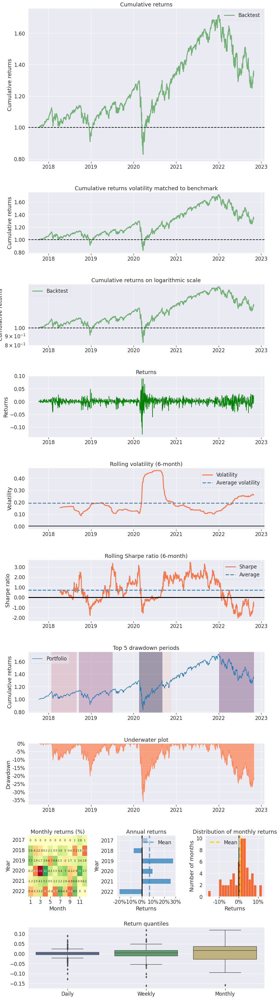

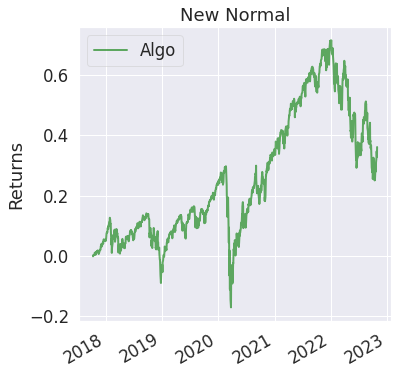

In [13]:
# Import pyfolio
import pyfolio as pf 

pf.create_full_tear_sheet(data_market['Market Log_Return'])

In [14]:
cum_ret = data_market['Market Return'].sum() + 1
print('The cumulative return is: ', cum_ret*100, '%')
print('The annual return is: ', pow(cum_ret, 252/len(data_market))*100, '%')

The cumulative return is:  154.1324210913615 %
The annual return is:  108.93460079425421 %


The corresponding annual and cumulative returns in the definition of our self-built backtest platform should be:

$$ {Annual\;Return} = 108.93\% $$

$$ {Cumulative\;Return} = 154.13\% $$

## Further Explorations

### Influence of Spread

In this part, we study the influence of the bid-ask spread of the tradable assets on the strategy's performance. Z, Z_e and Z_s are fixed to be the optimal Sharpe ratio values. **The spread is assumed to be a constant for both tradable assets for all days during the trading period.**

In [15]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
longcost = 0 
shortcost = 0 
# spread varies from 0 to 0.5 at step of 0.01
spreads = [spread*0.001 for spread in range(0,501,10)]

rets, vols, SRs = [], [], []
for spread in spreads:
    # trading on training data
    trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)
    rets.append(trade.get_return())
    vols.append(trade.get_vol())
    SRs.append(trade.get_Sharpe_ratio())

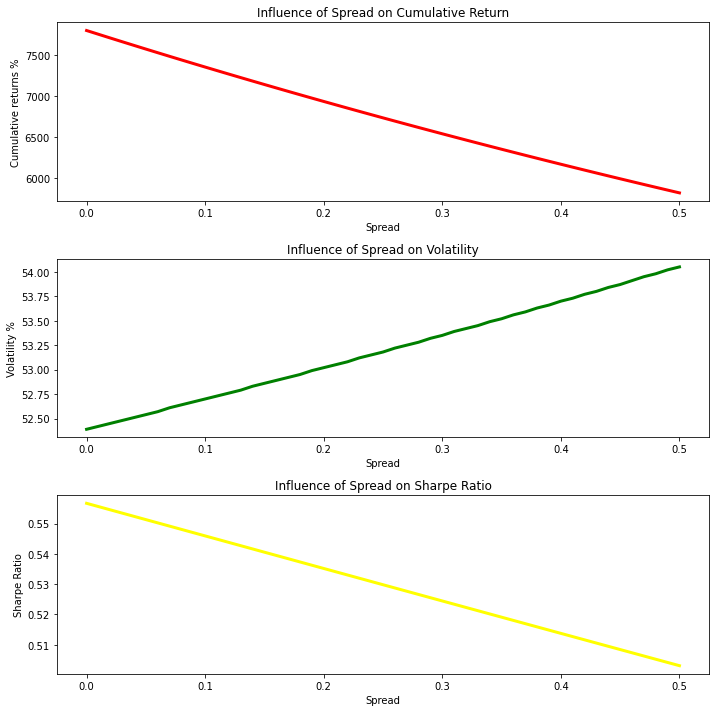

In [16]:
fig = plt.figure(figsize=(10,10))
# Influence on cumulative returns
plt.subplot(3, 1, 1)
plt.plot(spreads, rets, color='red',linewidth = 3)
plt.xlabel("Spread")
plt.ylabel("Cumulative returns %")
plt.title("Influence of Spread on Cumulative Return")

# Influence on vol
plt.subplot(3, 1, 2)
plt.plot(spreads, vols, color='green',linewidth = 3)
plt.xlabel("Spread")
plt.ylabel("Volatility %")
plt.title("Influence of Spread on Volatility")

# Influence on Sharpe Ratio
plt.subplot(3, 1, 3)
plt.plot(spreads, SRs, color='yellow',linewidth = 3)
plt.xlabel("Spread")
plt.ylabel("Sharpe Ratio")
plt.title("Influence of Spread on Sharpe Ratio")

fig.tight_layout()
plt.show()

Plots show that:

- 1. the spread monotonically decreases the cumulative returns;

- 2. the spread monotonically increases the volatility;

- 3. the spread monotonically decreases the Sharpe ratio.

### Influence of Transaction Cost of Longing

In this part, we study the influence of the transaction cost of longing the tradable assets on the strategy's performance. Z, Z_e and Z_s are fixed to be the optimal Sharpe ratio values. **The transaction cost is assumed to be a constant fraction of the trading amount for both tradable assets for all days during the trading period.**

In [17]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
spread = 0
shortcost = 0 
# longcost varies from 0 to 0.005 at step of 0.0001
longcosts = [longcost*0.0001 for longcost in range(0,51)]

rets, vols, SRs = [], [], []
for longcost in longcosts:
    # trading on training data
    trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)
    rets.append(trade.get_return())
    vols.append(trade.get_vol())
    SRs.append(trade.get_Sharpe_ratio())

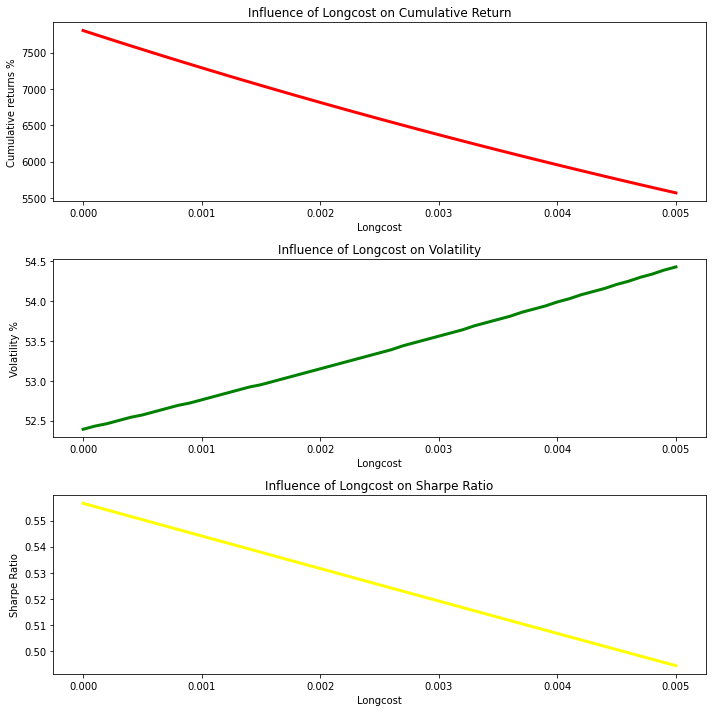

In [18]:
fig = plt.figure(figsize=(10,10))
# Influence on cumulative returns
plt.subplot(3, 1, 1)
plt.plot(longcosts, rets, color='red',linewidth = 3)
plt.xlabel("Longcost")
plt.ylabel("Cumulative returns %")
plt.title("Influence of Longcost on Cumulative Return")

# Influence on vol
plt.subplot(3, 1, 2)
plt.plot(longcosts, vols, color='green',linewidth = 3)
plt.xlabel("Longcost")
plt.ylabel("Volatility %")
plt.title("Influence of Longcost on Volatility")

# Influence on Sharpe Ratio
plt.subplot(3, 1, 3)
plt.plot(longcosts, SRs, color='yellow',linewidth = 3)
plt.xlabel("Longcost")
plt.ylabel("Sharpe Ratio")
plt.title("Influence of Longcost on Sharpe Ratio")

fig.tight_layout()
plt.show()

Plots show that:

- 1. the transaction cost for longing monotonically decreases the cumulative returns;

- 2. the transaction cost for longing monotonically increases the volatility;

- 3. the transaction cost for longing monotonically decreases the Sharpe ratio.

### Influence of Transaction Cost of Shorting

In this part, we study the influence of the transaction cost of shorting the tradable assets on the strategy's performance. Z, Z_e and Z_s are fixed to be the optimal Sharpe ratio values. **The transaction cost is assumed to be a constant fraction of the trading amount for both tradable assets for all days during the trading period.**

In [19]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
spread = 0
longcost = 0 
# shortcost varies from 0 to 0.005 at step of 0.0001
shortcosts = [shortcost*0.0001 for shortcost in range(0,51)]

rets, vols, SRs = [], [], []
for shortcost in shortcosts:
    # trading on training data
    trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)
    rets.append(trade.get_return())
    vols.append(trade.get_vol())
    SRs.append(trade.get_Sharpe_ratio())

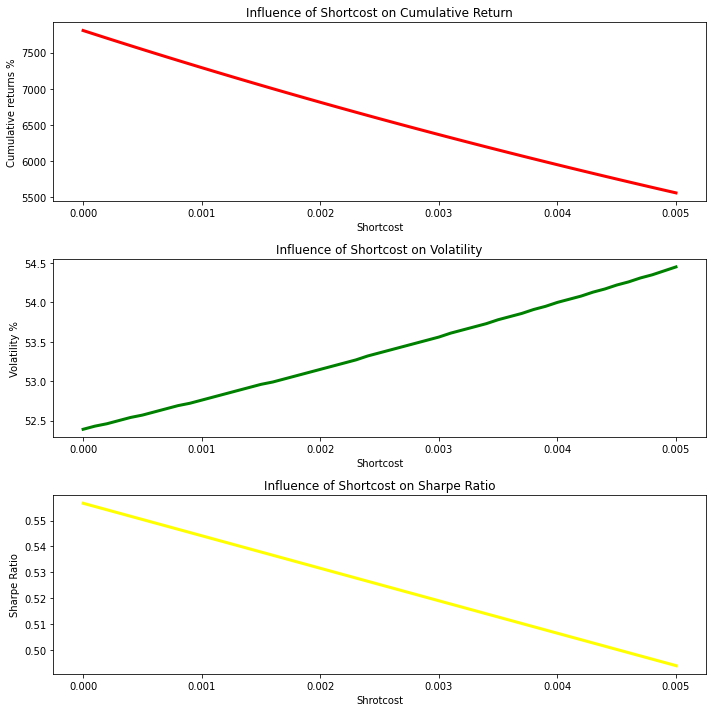

In [20]:
fig = plt.figure(figsize=(10,10))
# Influence on cumulative returns
plt.subplot(3, 1, 1)
plt.plot(shortcosts, rets, color='red',linewidth = 3)
plt.xlabel("Shortcost")
plt.ylabel("Cumulative returns %")
plt.title("Influence of Shortcost on Cumulative Return")

# Influence on vol
plt.subplot(3, 1, 2)
plt.plot(shortcosts, vols, color='green',linewidth = 3)
plt.xlabel("Shortcost")
plt.ylabel("Volatility %")
plt.title("Influence of Shortcost on Volatility")

# Influence on Sharpe Ratio
plt.subplot(3, 1, 3)
plt.plot(shortcosts, SRs, color='yellow',linewidth = 3)
plt.xlabel("Shrotcost")
plt.ylabel("Sharpe Ratio")
plt.title("Influence of Shortcost on Sharpe Ratio")

fig.tight_layout()
plt.show()

Plots show that:

- 1. the transaction cost for shorting monotonically decreases the cumulative returns;

- 2. the transaction cost for shorting monotonically increases the volatility;

- 3. the transaction cost for shorting monotonically decreases the Sharpe ratio.

- 4. the transaction cost for longing and shorting have the same kind of impact and the same strength of influence on the strategy's performance.

### Robustness of $\mu_{e}$

In this part, we study the robustness of the parameter $\mu_{e}$ on the strategy's performance. Unlike the parameter $\sigma_{eq}$ which can be adjusted by the parameters Z, Z_e and Z_s, $\mu_{e}$ does not have any adjusting coefficient in front of it. So it is important to study the influence of the uncertainty of $\mu_{e}$ on the strategy, which is also called the *Robustness*. **A list of slight bias which range from -25% to 25% at step of 2.5% are applied to $\mu_{e}$ and a plots of the cumulative return, volatility and Sharpe ratio against bias will be shown.**

In [21]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
spread = 0
longcost = 0 
shortcost = 0
# bias varies from -25% to 25% at step of 2.5%
bias_list = [(bias-250)*0.001 for bias in range(0,501,25)]

rets, vols, SRs = [], [], []
for bias in bias_list:
    # update the mu_e to the biased one 
    trade.update_mu_e(bias)
    # trading on training data
    trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)
    rets.append(trade.get_return())
    vols.append(trade.get_vol())
    SRs.append(trade.get_Sharpe_ratio())
    # reset to the original mu_e
    trade.fitting(data_train['Feeder Cattle'], data_train['Live Cattle'])

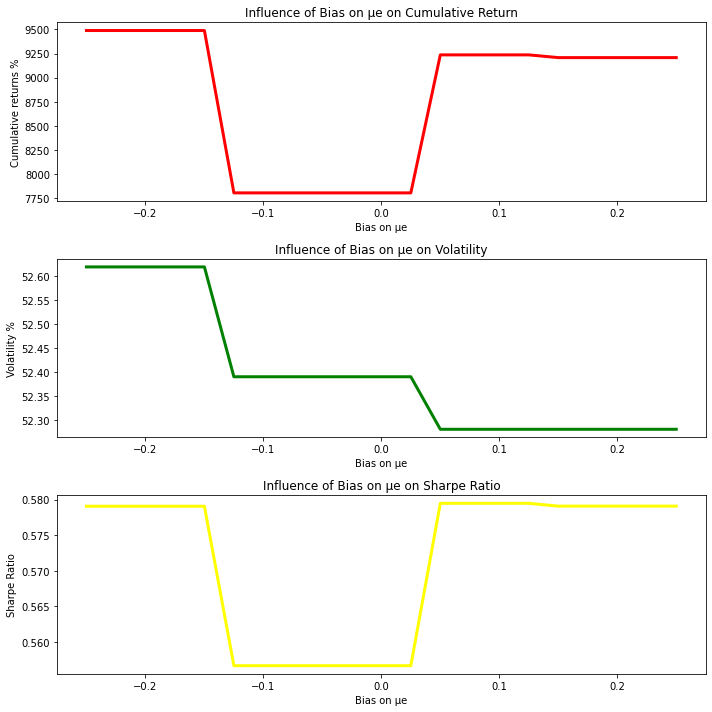

In [22]:
fig = plt.figure(figsize=(10,10))
# Influence on cumulative returns
plt.subplot(3, 1, 1)
plt.plot(bias_list, rets, color='red',linewidth = 3)
plt.xlabel("Bias on μe")
plt.ylabel("Cumulative returns %")
plt.title("Influence of Bias on μe on Cumulative Return")

# Influence on vol
plt.subplot(3, 1, 2)
plt.plot(bias_list, vols, color='green',linewidth = 3)
plt.xlabel("Bias on μe")
plt.ylabel("Volatility %")
plt.title("Influence of Bias on μe on Volatility")

# Influence on Sharpe Ratio
plt.subplot(3, 1, 3)
plt.plot(bias_list, SRs, color='yellow',linewidth = 3)
plt.xlabel("Bias on μe")
plt.ylabel("Sharpe Ratio")
plt.title("Influence of Bias on μe on Sharpe Ratio")

fig.tight_layout()
plt.show()

From the plots above, we can see that the influence of the biased $\mu_{e}$ on the strategy's performance is not as simple as the influences of bid-ask spread and transaction costs:

- 1. The influence of the biased $\mu_{e}$ on the performance is not monotonic: the cumulative returns, volatility and Sharpe ratio could increase or decrease as the bias $\mu_{e}$ monotonically increasing


- 2. The influence of the biased $\mu_{e}$ on the performance is not continuos: the changes in cumulative returns, volatility and Sharpe ratio are step like. In most cases, the changes of $\mu_{e}$ do not produce changes in cumulative returns, volatility and Sharpe ratio. However, sometimes the changes of $\mu_{e}$ make cumulative returns, volatility and Sharpe ratio jumps to another level. This should be due to the trading signal generation mechanism: 

    The trading bounds $\mu_{e} \pm Z\sigma_{eq}$, $\mu_{e} \pm Z_{s}\sigma_{eq}$ and $\mu_{e} \pm Z_{e}\sigma_{eq}$ are influenced by the change of $\mu_{e}$. However, as the change of $mu_{e}$ are quite small comparing to the value of $Z\sigma_{eq}$ and $Z_{s}\sigma_{eq}$, in most cases the small changes of the bounds caused by $\mu_{e}$ do not influence the number of *trades*. Also the change in P&L of each *trade* caused by the change of bounds is 0 because the different bounds change in parallel way, their influences on P&L cancel each other out and results in no difference on the cumulative returns, volatility and Sharpe ratio. This is the reason why in most cases, the changes of $\mu_{e}$ do not produce changes in cumulative returns, volatility and Sharpe ratio.
    
    However, sometimes the small changed new bounds caused by the change of $\mu_{e}$ trigger new trading signals or disable the original trading signals, which generates new *trades* or kills some original *trades*. If this happens, there will be step changes on the cumulative returns, volatility and Sharpe ratio.

### Total Number of *Trades*

In this part, we study the relationship between total number of *trades* and the strategy's performance. With all the parameters except $Z$ fixed to be the optimal Sharpe ratio setting, $Z$ varies from 0.1 to 2.0 at the step of 0.1. The total numbers of *trades* are recorded together with the corresponding cumulative returns, volatilities and Sharpe ratios. Among all the cumulative returns with the same total number of *trades*, the maximum one selected to represent the cumulative return for that number of *trades*. The same methodology applies to volatility and Sharpe ratio metrices as well.

In [23]:
# optimal values
Z_e = 0.03
Z_s = 2.8
spread = 0
longcost = 0
shortcost = 0
# Z varies from 0.1 to 1.9 at step of 0.1
Z_list = [Z*0.1 for Z in range(1,21,1)]

nums_, rets_, vols_, SRs_ = [], [], [], []
for Z in Z_list:
    # trading on training data
    trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)
    nums_.append(trade.get_num_of_trades())
    rets_.append(trade.get_return())
    vols_.append(trade.get_vol())
    SRs_.append(trade.get_Sharpe_ratio())

# deduplicate
nums = sorted(list(set(nums_)))
# metrices for each different number of trades
rets, vols, SRs = [], [], []
for i in range(len(nums)):
    # metrices for the same number of trades
    ret = []
    vol = [] 
    SR = []
    for j in range(len(nums_)):
        if nums_[j] == nums[i]:
            ret.append(rets_[j])
            vol.append(vols_[j]) 
            SR.append(SRs_[j])
    # maximal is selected to represent the performance of this number of trades
    rets.append(max(ret))
    vols.append(max(vol))
    SRs.append(max(SR))

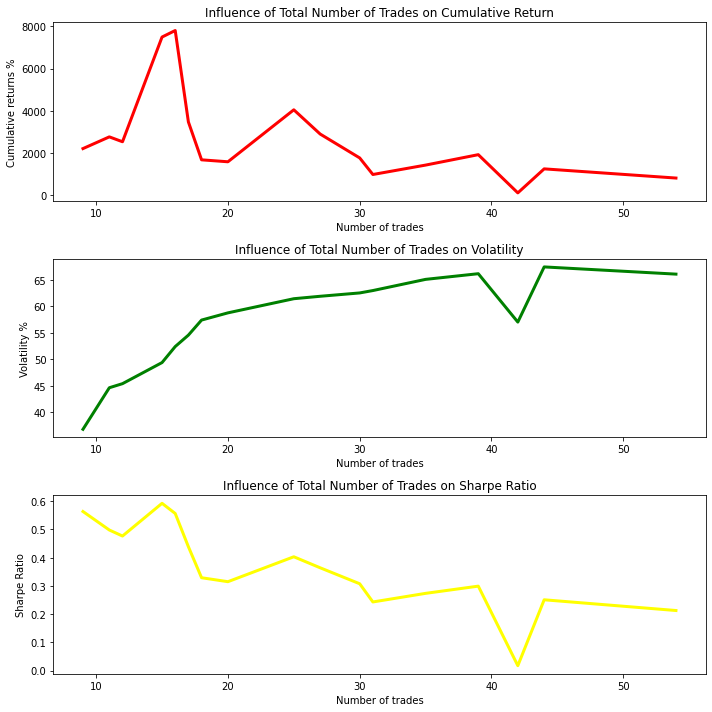

In [24]:
fig = plt.figure(figsize=(10,10))
# Influence on cumulative returns
plt.subplot(3, 1, 1)
plt.plot(nums, rets, color='red',linewidth = 3)
plt.xlabel("Number of trades")
plt.ylabel("Cumulative returns %")
plt.title("Influence of Total Number of Trades on Cumulative Return")

# Influence on vol
plt.subplot(3, 1, 2)
plt.plot(nums, vols, color='green',linewidth = 3)
plt.xlabel("Number of trades")
plt.ylabel("Volatility %")
plt.title("Influence of Total Number of Trades on Volatility")

# Influence on Sharpe Ratio
plt.subplot(3, 1, 3)
plt.plot(nums, SRs, color='yellow',linewidth = 3)
plt.xlabel("Number of trades")
plt.ylabel("Sharpe Ratio")
plt.title("Influence of Total Number of Trades on Sharpe Ratio")

fig.tight_layout()
plt.show()

With $Z_{e}$ and $Z_{s}$ fixed, the total number of *trade* can be regarded as being proportional to $\frac{1}{Z}$. According to the plots above:

- 1. The relationship between the cumulative return and total number of *trades*, or $Z$, is not linear nor monotonic. However, the cumulative return is influenced a lot by the total number of *trades* as there is a huge difference between the maximal and minimal cumulative return in the plot. The general trend in our case is that with total number of *trades* increasing/$Z$ decreasing, the cumulative return drops. The highest return is around total number of *trade* of 16.


- 2. The total number of *trades*/$\frac{1}{Z}$ is almost monotonically increasing the volatility, which means the more *trades* we make, the more risk we take. However, when the total number of *trades* becomes very high, like more than 43, there is a slight trend of decreasing volatility as the total number of *trades* increases. In this case, parameter $Z$ is already very small; so the further decreasing of $Z$ doesn't influence the volatility and the return that much anymore.


- 3. The curve of the influence of total number of *trades* on Sharpe ratio shows the general trend of decreasing due to the general trend of cumulative return. The maximal of Sharpe ratio happens around the total number of *trades* of 16, which is consistent to the backtest result obtained with the optimal Sharpe ratio settings.

### Optimisation of Z, Z_e and Z_s with Spread and Transaction cost

Same as before, we optimise Z, Z_e and Z_s with spread of 0.5, longcost of 0.0002 and shortcost of 0.0002.

In [22]:
# search begins
best_params = GridSearch_for_Z(trade, _Z, _Z_e, _Z_s, 0.5, 0.0002, 0.0002)

There are 27 candidates of Z; 6 candidates of Z_e; 15 candidates of Z_s; 

 2430 searches in total
Best score (Sharpe Ratio) is 0.5
{'Z': 1.5, 'Z_e': 0.03, 'Z_s': 2.8000000000000003}


In [23]:
best_params

{'Z': 1.5, 'Z_e': 0.03, 'Z_s': 2.8000000000000003}

Because the influences of spread and transaction costs are the same in monotonically decreasing Sharpe ratio, so the optimal values of Z, Z_e and Z_s do not change. However, the optimal Sharpe ratio has decreased. Now let's see the optimal Sharpe ratio backtest result with non-zero spread and trasnaction cost.

## Backtest of Optimal Sharpe Ratio Strategy with Spread and Transaction Costs on Training Set

In [25]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
spread = 0.5
longcost = 0.0002 
shortcost = 0.0002
# trading on training data
trade.trading(data_train, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)

# backtest
# maximum acceptable drawdown is -70% 
MADD = 0.7
output = True
trade.backtest(MADD ,output)

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2002-03-05 |
| End Date                       | 2017-10-05 |
| Total number of trades         | 16.0       |
| Average trades per year        | 1.07       |
| Average trading days(Calender) | 136.69     |
| Annual Return                  | 131.02%    |
| Cumulative Return              | 5660.64%   |
| Average Return per trade       | 128.69%    |
| Annual volatility              | 40.38%     |
| Annual Alpha                   | 0.26       |
| Beta                           | 0.09       |
| Information Ratio              | 0.52       |
| Sharpe Ratio                   | 0.54       |
| Max Drawdown                   | -54.7%     |
| Daily Value at Risk(99%)       | -5.81%     |
| Drawdown Control               | False      |


From the table, we have:

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2002-03-05 |
| End Date                       | 2017-10-05 |
| Total number of trades         | 16.0       |
| Average trades per year        | 1.07       |
| Average trading days(Calender) | 136.69     |
| Annual Return                  | 131.02%    |
| Cumulative Return              | 5660.64%   |
| Average Return per trade       | 128.69%    |
| Annual volatility              | 40.38%     |
| Annual Alpha                   | 0.26       |
| Beta                           | 0.09       |
| Information Ratio              | 0.52       |
| Sharpe Ratio                   | 0.54       |
| Max Drawdown                   | -54.7%     |
| Daily Value at Risk(99%)       | -5.81%     |
| Drawdown Control               | False      |

Cumulative return drops from 7804.86% to 5660.64%; annual return drops from 133.86% to 131.02%; annual alpha decreases from 0.29 to 0.26. 

Anuual volatility increases from 39.33% to 40.38%; max drawdown increases from 53.47% to 54.7%; daily VaR increases from 5.65% to 5.81%. Beta also increases a little bit from 0.08 to 0.09. And moreover, the drawdown is out of control with MADD=0.7 as before while considering the spread and transaction costs into account.

Sharpe ratio drops from 0.57 to 0.54; information ratio from 0.55 to 0.52.

The result is foreseeable and consistent to the study of **Further Explorations**. Bid-ask spread and transaction costs increase the risk of the strategy while reducing the return.

An obvious difference is found in the plot **Bid, Ask and Trading Prices of Portfolio**: by considering the bid-ask spread and transaction costs, bid price and ask price of the portfolio are different now. Trading price of the portfolio equals to either of them according to the current position.

## Backtest of Optimal Sharpe Ratio Strategy with Spread and Transaction Costs on Testing Set

In [26]:
# optimal values
Z = 1.5
Z_e = 0.03
Z_s = 2.8
spread = 0.5
longcost = 0.0002 
shortcost = 0.0002
# trading on training data
trade.trading(data_test, 'Feeder Cattle', 'Live Cattle', Z, Z_e, Z_s, spread, longcost, shortcost)

# backtest
# maximum acceptable drawdown is -70% 
MADD = 0.7
output = True
trade.backtest(MADD ,output)

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2017-10-09 |
| End Date                       | 2022-10-28 |
| Total number of trades         | 8.0        |
| Average trades per year        | 1.61       |
| Average trading days(Calender) | 111.0      |
| Annual Return                  | 156.44%    |
| Cumulative Return              | 928.86%    |
| Average Return per trade       | 126.27%    |
| Annual volatility              | 61.94%     |
| Annual Alpha                   | 0.45       |
| Beta                           | 0.04       |
| Information Ratio              | 0.7        |
| Sharpe Ratio                   | 0.74       |
| Max Drawdown                   | -58.22%    |
| Daily Value at Risk(99%)       | -8.89%     |
| Drawdown Control               | False      |


We apply the same optimal Sharpe ratio parameter settings obatained from the optimisation based on the training set to the backtest on testing set. The backtest table for testing dataset is presented below:

|                                | Backtest   |
|:-------------------------------|:-----------|
| Start Date                     | 2017-10-09 |
| End Date                       | 2022-10-28 |
| Total number of trades         | 8.0        |
| Average trades per year        | 1.61       |
| Average trading days(Calender) | 111.0      |
| Annual Return                  | 156.44%    |
| Cumulative Return              | 928.86%    |
| Average Return per trade       | 126.27%    |
| Annual volatility              | 61.94%     |
| Annual Alpha                   | 0.45       |
| Beta                           | 0.04       |
| Information Ratio              | 0.7        |
| Sharpe Ratio                   | 0.74       |
| Max Drawdown                   | -58.22%    |
| Daily Value at Risk(99%)       | -8.89%     |
| Drawdown Control               | False      |


Cumulative return drops from 1092.22% to 928.86%; annual return drops from 161.62% to 156.44%; annual alpha decreases from 0.49 to 0.45. 

Anuual volatility increases from 60.25% to 61.94%; max drawdown increases from 56.94% to 58.22%; daily VaR increases from 8.62% to 8.89%. Beta also drops a little bit from 0.05 to 0.04. Drawdown is still out of control with MADD=0.7. However, with non-zero bid-ask spread and transaction costs, the least MADD that makes the drawdown in control increases from 0.75 to 0.77.

Sharpe ratio drops from 0.79 to 0.74; information ratio from 0.75 to 0.7.

The conclusion is the same as the one on the training set: bid-ask spread and transaction costs increase the risk of the strategy while reducing the return.

Same as before, the obvious difference is found in the plot **Bid, Ask and Trading Prices of Portfolio**: by considering the bid-ask spread and transaction costs, bid price and ask price of the portfolio are different now. Trading price of the portfolio equals to either of them according to the current position.

In [27]:
# delete the instance
del trade